
# Image Classification using Convolutional Neural Networks (CNNs)
***Objective:***

The objective of this exercise is to provide students with hands-on experience in building, training, and evaluating a Convolutional Neural Network (CNN) for image classification using the Caltech101 dataset. Students will learn the principles of CNNs, including convolutional layers, pooling layers, and fully connected layers, as well as techniques for data augmentation and model evaluation.


***Dataset:***

Caltech101: This dataset contains 101 categories of objects, with approximately 40 to 800 images per category. The images are of various sizes, but most are medium resolution.


In [3]:
import tensorflow as tf
from keras import layers, models
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import itertools

2024-08-06 09:06:39.170773: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-06 09:06:39.216565: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-06 09:06:39.228682: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-06 09:06:39.247100: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-06 09:06:39.253963: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-06 09:06:39.289663: I tensorflow/core/platform/cpu_feature_gu


Dataset Preparation:

1. Download the Caltech101 dataset and organize it into training and testing sets.

2. Apply data preprocessing techniques such as resizing images to a consistent size, normalizing pixel values, and data augmentation (rotation, scaling, flipping, etc.).



In [5]:
(train_dataset, test_dataset), dataset_info = tfds.load(
    name='caltech101:3.0.2',
    split=['train[:80%]','train[:20%]'],
    with_info=True,
    as_supervised=True,
    data_dir='./data',
)

2024-08-06 09:07:28.892282: W external/local_tsl/tsl/platform/cloud/google_auth_provider.cc:184] All attempts to get a Google authentication bearer token failed, returning an empty token. Retrieving token from files failed with "NOT_FOUND: Could not locate the credentials file.". Retrieving token from GCE failed with "FAILED_PRECONDITION: Error executing an HTTP request: libcurl code 6 meaning 'Couldn't resolve host name', error details: Could not resolve host: metadata.google.internal".


/home/jefferson/Documents/Recuperaci-n-de-la-informacion-deberes/env/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Dl Completed...: 0 url [00:00, ? url/s]
Dl Completed...: 100%|██████████| 1/1 [01:39<00:00, 98.55s/ url]

Extraction completed...: 100%|██████████| 9145/9145 [00:33<00:00, 275.65 file/s]  


Dataset caltech101 downloaded and prepared to ./data/caltech101/3.0.2. Subsequent calls will reuse this data.



### ***Data loading:***

tfds.load: This function loads the specified dataset. Here, it's loading the 'caltech101' dataset with version '3.0.2'.

split=['train[:80%]','train[:20%]']: The dataset is split into two parts: 80% for training and 20% for testing.

with_info=True: This flag indicates that additional metadata about the dataset should be returned, such as the number of classes.

as_supervised=True: This ensures that the data is returned as a tuple (image, label) rather than a dictionary. This format is typical for supervised learning tasks.

download=False: This prevents the code from downloading the dataset if it is not already available locally. In our case, we dont use this parameter.



In [6]:
num_classes = dataset_info.features['label'].num_classes

In [7]:
num_classes

102

In [8]:
def preprocess_image(image, label):
    image = tf.image.resize(image, (224, 224))
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

In [9]:
train_dataset = train_dataset.map(preprocess_image).shuffle(1000).batch(32)
test_dataset = test_dataset.map(preprocess_image).batch(32)


### ***Data preprocessing:***

tf.image.resize(image, (224, 224)): Resizes each image to 224x224 pixels. This is a common size for CNN inputs, such as those used in models like VGG and ResNet.

tf.cast(image, tf.float32) / 255.0: Converts the pixel values to float32 and normalizes them to the range [0, 1]. This normalization helps improve the convergence of neural networks during training.


In [10]:
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    #layers.Dropout(0.2),
    layers.Dense(num_classes, activation='softmax')
])


/home/jefferson/Documents/Recuperaci-n-de-la-informacion-deberes/env/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2024-08-06 09:10:31.993470: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 95551488 exceeds 10% of free system memory.
2024-08-06 09:10:32.070784: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 95551488 exceeds 10% of free system memory.
2024-08-06 09:10:32.132899: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 95551488 exceeds 10% of free system memory.


In [7]:
from tensorflow.keras import models, layers, Input

# Definir la forma de entrada
input_shape = (224, 224, 3)

# Crear el modelo
model = models.Sequential([
    Input(shape=input_shape),  # Capa de entrada explícita
    layers.Conv2D(32, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dense(num_classes, activation='softmax')
])



### ***Model definition:***

models.Sequential: This specifies a linear stack of layers. The layers are added sequentially, meaning each layer has exactly one input tensor and one output tensor.

layers.Conv2D(32, (3, 3), activation='relu'): This layer creates 32 filters, each of size 3x3, which convolve over the input image. The activation function used is ReLU (Rectified Linear Unit), which introduces non-linearity into the model. input_shape=(224, 224, 3): Specifies the input shape, where 224x224 is the image size and 3 is the number of color channels (RGB).

layers.MaxPooling2D((2, 2)): This layer performs max pooling with a 2x2 filter, reducing the spatial dimensions (height and width) by half. It helps in reducing the computational complexity and the risk of overfitting by down-sampling the input.

layers.Conv2D(64, (3, 3), activation='relu'): This layer increases the number of filters to 64, with each filter of size 3x3. This deeper layer can learn more complex features.

layers.Flatten(): This layer flattens the 2D outputs from the previous layer into a 1D vector, preparing the data for the fully connected layers.

layers.Dense(128, activation='relu'): A dense layer with 128 units and ReLU activation. Dense layers are fully connected, meaning each neuron in the layer receives input from all neurons in the previous layer. This layer helps in learning complex


layers.Dense(num_classes, activation='softmax'): The output layer with a number of units equal to the number of classes (num_classes). The softmax activation function is used, which outputs a probability distribution over the classes, making it suitable for multi-class classification.


In [11]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

print(model.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 186624)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    23,888,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 102)            │        13,158 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,920,550 (91.25 MB)

 Trainable params: 23,920,550 (91.25 MB)

 Non-trainable params: 0 (0.00 B)

None


In [12]:
history=model.fit(train_dataset, epochs=6, validation_data=test_dataset)

Epoch 1/6


2024-08-06 09:10:51.581885: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 95551488 exceeds 10% of free system memory.
2024-08-06 09:10:53.087138: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 19267584 exceeds 10% of free system memory.


77/77 ━━━━━━━━━━━━━━━━━━━━ 191s 2s/step - accuracy: 0.0168 - loss: 6.8228 - val_accuracy: 0.1160 - val_loss: 4.1993
Epoch 2/6
77/77 ━━━━━━━━━━━━━━━━━━━━ 162s 2s/step - accuracy: 0.1613 - loss: 3.9029 - val_accuracy: 0.6699 - val_loss: 1.7608
Epoch 3/6
77/77 ━━━━━━━━━━━━━━━━━━━━ 144s 2s/step - accuracy: 0.7439 - loss: 1.2936 - val_accuracy: 0.9510 - val_loss: 0.3336
Epoch 4/6
77/77 ━━━━━━━━━━━━━━━━━━━━ 162s 2s/step - accuracy: 0.9624 - loss: 0.2451 - val_accuracy: 0.9967 - val_loss: 0.0524
Epoch 5/6
77/77 ━━━━━━━━━━━━━━━━━━━━ 141s 2s/step - accuracy: 0.9889 - loss: 0.0573 - val_accuracy: 0.9755 - val_loss: 0.1459
Epoch 6/6
77/77 ━━━━━━━━━━━━━━━━━━━━ 147s 2s/step - accuracy: 0.9895 - loss: 0.0983 - val_accuracy: 0.9984 - val_loss: 0.0257



### ***Model compilation:***

optimizer='adam': The Adam (Adaptive Moment Estimation) optimizer is used to adjust the model's weights during training. Adam is a popular choice because it combines the advantages of two other extensions of stochastic gradient descent: Adaptive Gradient Algorithm (AdaGrad) and Root Mean Square Propagation (RMSProp). It adapts the learning rate for each parameter, making the optimization process more efficient and potentially leading to faster convergence.

loss='sparse_categorical_crossentropy': This loss function is used for multi-class classification problems where the target labels are integers. In this case, the labels are provided as integers (e.g., 0, 1, 2, ...) rather than one-hot encoded vectors. The sparse categorical crossentropy computes the cross-entropy loss between the true labels and the predicted probabilities, which is suitable for multi-class classification tasks.

metrics=['accuracy']: This specifies that accuracy will be tracked during training and evaluation. Accuracy is a common metric for classification tasks, representing the proportion of correctly predicted samples.


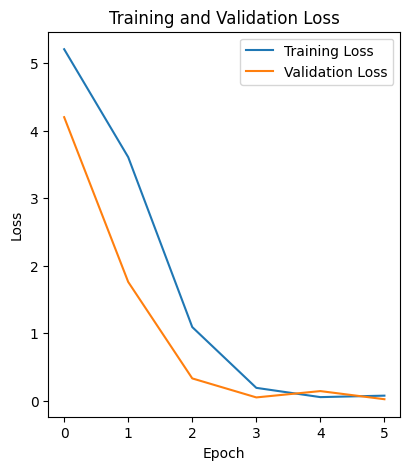

In [13]:
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()

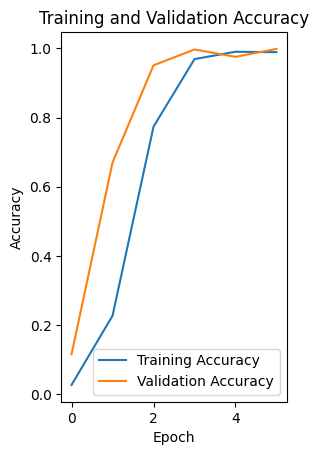

In [14]:
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()

In [15]:
num_params = model.count_params()
print(f"Number of trainable parameters in the model: {num_params}")


Number of trainable parameters in the model: 23920550


In [16]:
loss, accuracy = model.evaluate(test_dataset)
print(f"Accuracy on the test set: {accuracy * 100:.2f}%")

20/20 ━━━━━━━━━━━━━━━━━━━━ 5s 257ms/step - accuracy: 0.9980 - loss: 0.0168
Accuracy on the test set: 99.84%


In [17]:
misclassified_images = []
misclassified_labels = []
for image, label in test_dataset:
    predictions = model.predict(image)
    predicted_label = np.argmax(predictions, axis=1)
    misclassified_idx = np.where(predicted_label != label.numpy())[0]
    for idx in misclassified_idx:
        misclassified_images.append(image[idx])
        misclassified_labels.append(predicted_label[idx])



1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 609ms/step


2024-08-06 09:28:44.665560: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [18]:
len(misclassified_images)

1

Number of misclassified images found: 1


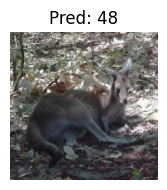

In [19]:
# Number of misclassified images found
num_misclassified = len(misclassified_images)
print(f"Number of misclassified images found: {num_misclassified}")

# Check if there are no misclassified images
if num_misclassified == 0:
    print("No misclassified images to display.")
else:
    # Number of images to display (adjusted to the number of misclassified images if fewer)
    num_images_to_show = min(num_misclassified, 400)  # Show up to 400 images or the total available
    grid_size = int(np.ceil(np.sqrt(num_images_to_show)))  # Determine grid size (handles the case where num_images_to_show is not a perfect square)

    # If there are more images, select a random subset
    if num_misclassified > num_images_to_show:
        indices = np.random.choice(num_misclassified, num_images_to_show, replace=False)
        selected_images = [misclassified_images[i] for i in indices]
        selected_labels = [misclassified_labels[i] for i in indices]
    else:
        selected_images = misclassified_images
        selected_labels = misclassified_labels

    # Figure size setup
    fig, axes = plt.subplots(grid_size, grid_size, figsize=(grid_size * 2, grid_size * 2))  # Size adjusted based on grid size

    # If grid size is 1x1, axes is a single Axes object, not an array
    if grid_size == 1:
        axes = np.array([[axes]])

    # Display images in the grid
    for i in range(grid_size):
        for j in range(grid_size):
            index = i * grid_size + j
            if index < len(selected_images):
                axes[i, j].imshow(selected_images[index])
                axes[i, j].set_title(f"Pred: {selected_labels[index]}")
            axes[i, j].axis('off')  # Turn off the axes

    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


2024-08-06 09:28:58.465952: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


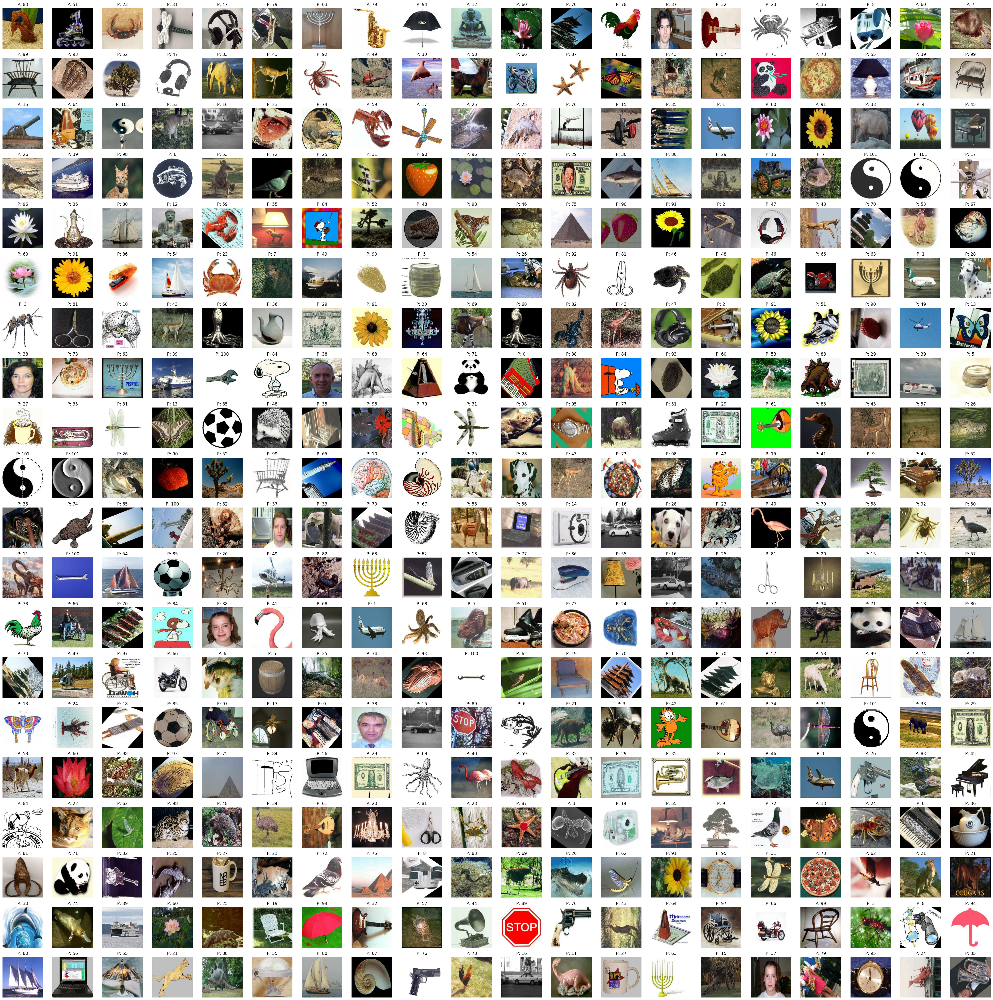

In [20]:
# Collect niceclassified images and labels
niceclassified_images = []
niceclassified_labels = []
for image, label in test_dataset:
    predictions = model.predict(image)
    predicted_label = np.argmax(predictions, axis=1)
    niceclassified_idx = np.where(predicted_label == label.numpy())[0]
    for idx in niceclassified_idx:
        niceclassified_images.append(image[idx])
        niceclassified_labels.append(predicted_label[idx])

# Limit to the first 400 images if there are more
num_images_to_show = min(len(niceclassified_images), 400)
niceclassified_images = niceclassified_images[:num_images_to_show]
niceclassified_labels = niceclassified_labels[:num_images_to_show]

# Determine grid size
grid_size = int(np.ceil(np.sqrt(num_images_to_show)))  # e.g., 20 for 400 images

# Plotting setup
plt.figure(figsize=(grid_size * 2, grid_size * 2))  # Adjust figure size based on grid size

# Plot images in the grid
for i in range(num_images_to_show):
    plt.subplot(grid_size, grid_size, i + 1)
    plt.imshow(niceclassified_images[i])
    plt.title(f"P: {niceclassified_labels[i]}")
    plt.axis('off')  # Turn off the axis

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

In [19]:
from tensorflow.keras import models, layers

In [20]:
print(model.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 222, 222, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 111, 111, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 109, 109, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 54, 54, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 186624)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      23,888,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 102)                 │          13,158 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 71,761,652 (273.75 MB)

 Trainable params: 23,920,550 (91.25 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 47,841,102 (182.50 MB)

None


In [21]:
sample_image, _ = next(itertools.islice(iter(test_dataset), 0, 1))
sample_image = sample_image[:1]

activation_model = models.Model(inputs=model.input,
                                outputs=[layer.output for layer in model.layers])
# activation_model = models.Model(inputs=model.input, outputs=model.layers[4].output)
activations = activation_model.predict(sample_image)

plt.figure(figsize=(10, 5))
for i, activation in enumerate(activations):
    plt.subplot(2, 4, i+1)
    try:
        plt.imshow(activation[0, :, :, 0], cmap='viridis')
    except:
        pass
    plt.title(f"Activation {i+1}")
    plt.axis('off')
plt.show()


ValueError: The layer sequential has never been called and thus has no defined input.